<a href="https://colab.research.google.com/github/jinghui00/Robotic-Garbage-Sorter/blob/main/YOLOv5_Custom_Training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Step 1: Install Requirements

In [ ]:
# clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 14936, done.
remote: Total 14936 (delta 0), reused 0 (delta 0), pack-reused 14936
Receiving objects: 100% (14936/14936), 13.98 MiB | 25.35 MiB/s, done.
Resolving deltas: 100% (10267/10267), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 43.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 KB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 KB 17.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
Setup complete. Using torch 1.13.0+cu116 (Tesla T4)


# Step 2: Import dataset

In [ ]:
# import Roboflow
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In Roboflow, go to your project. After you generate a version, there will be an export option. 

Choose `YOLO v5 Pytorch` and `show download code`.

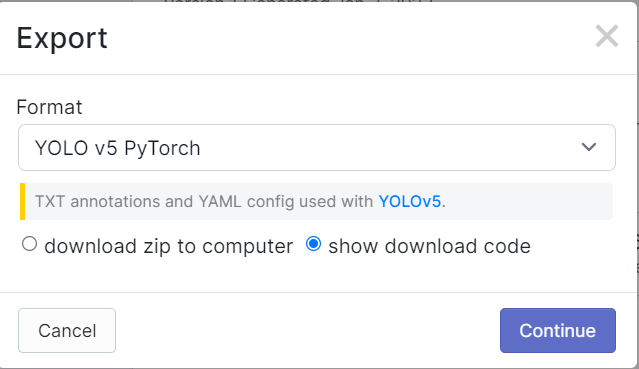

Copy the code snippet.

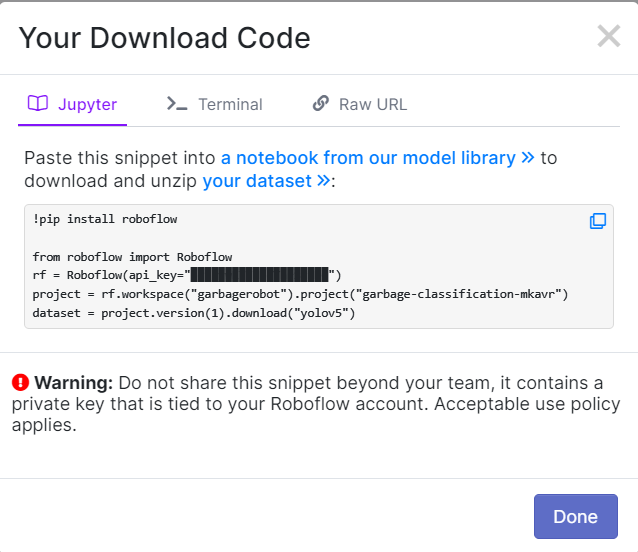

In [ ]:
# replace the snippet here
from roboflow import Roboflow
rf = Roboflow(api_key="pPhbywK7TN1dYhrSvNzC")
project = rf.workspace("garbagerobot").project("garbage-classification-mkavr")
dataset = project.version(1).download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/garbage-classification-1 in yolov5pytorch:: 100%|██████████| 9996/9996 [00:03<00:00, 3261.37it/s]


# Step 3: Train Our Custom YOLOv5 model

Here, you can pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. 
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. 
- **cache:** cache images for faster training

In [ ]:
!python train.py --img 640 --batch 16 --epochs 150 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/garbage-classification-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-59-gfdc35b1 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=

# Step 4: Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

# Step 5: Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

Here, you can pass a number of arguments:
- **weights:** specify a path to weights. Usually, use `best.pt` 
- **img:** define input image size
- **conf:** confidence threshold
- **source:** specify a path to test dataset

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/garbage-classification-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-59-gfdc35b1 Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/96 /content/datasets/garbage-classification-1/test/images/paper-211-_JPG.rf.b666a3f9d4b850f2232e8e21482f37df.jpg: 416x416 1 paper, 12.5ms
image 2/96 /content/datasets/garbage-classification-1/test/images/paper-218-_JPG.rf.b0c49b9de3167fd9ba7517469b55c187.jpg: 416x416 1 paper, 8.3ms
image 3/96 /content/da

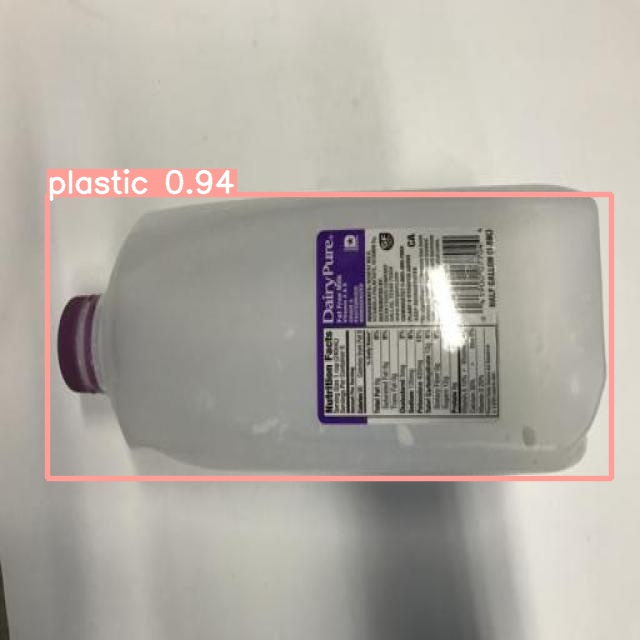

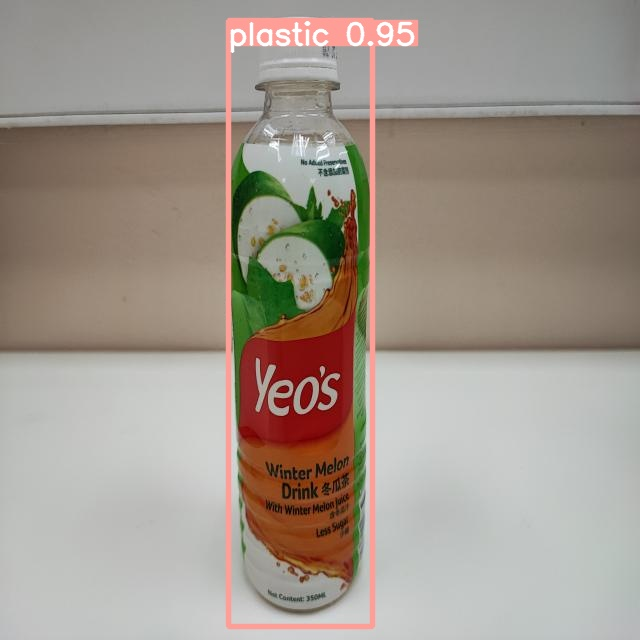

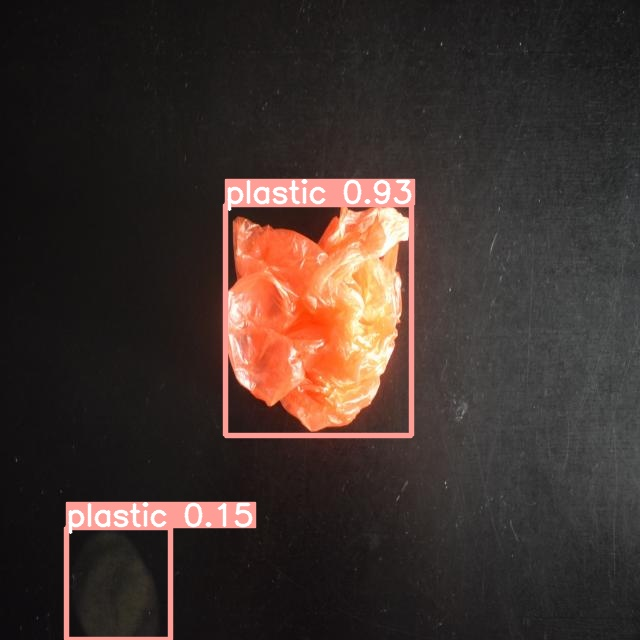

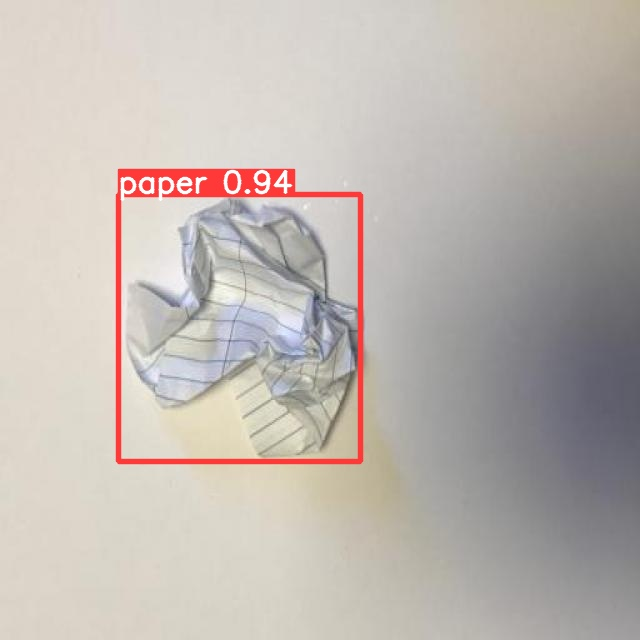

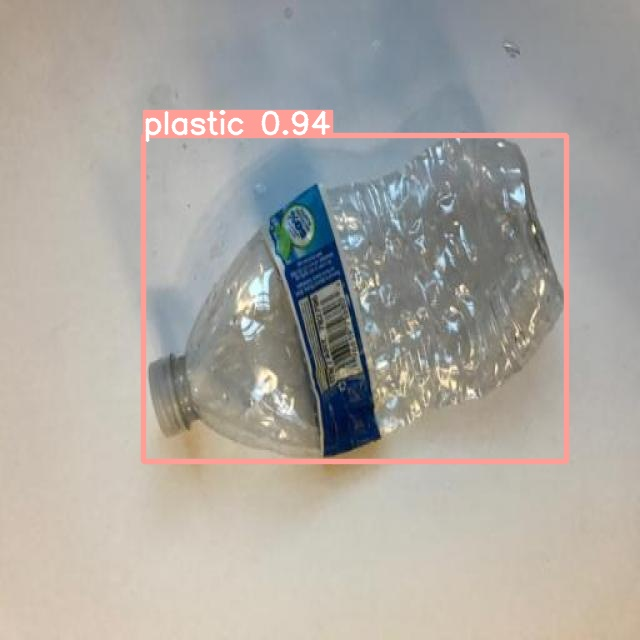

...

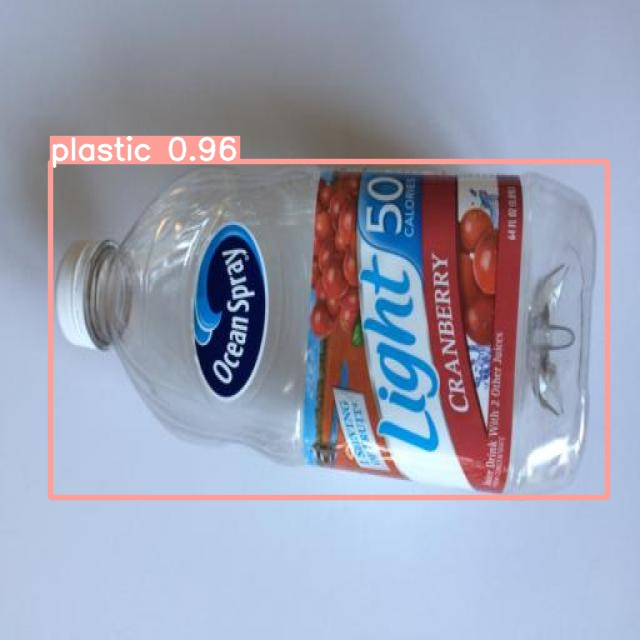

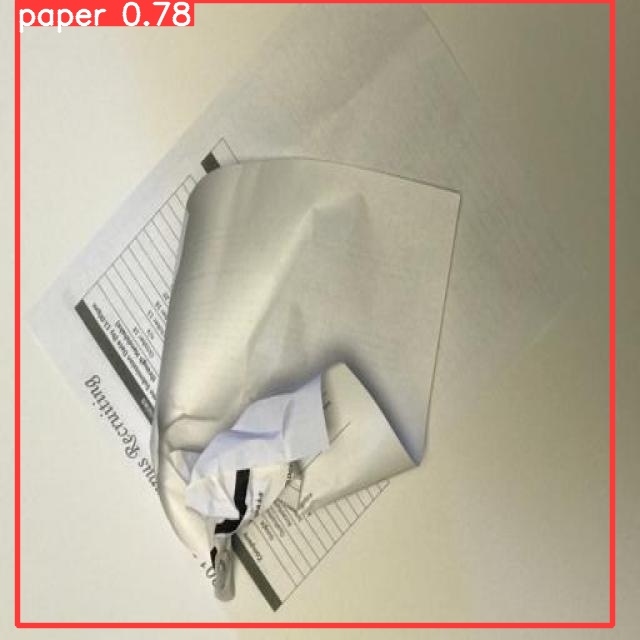

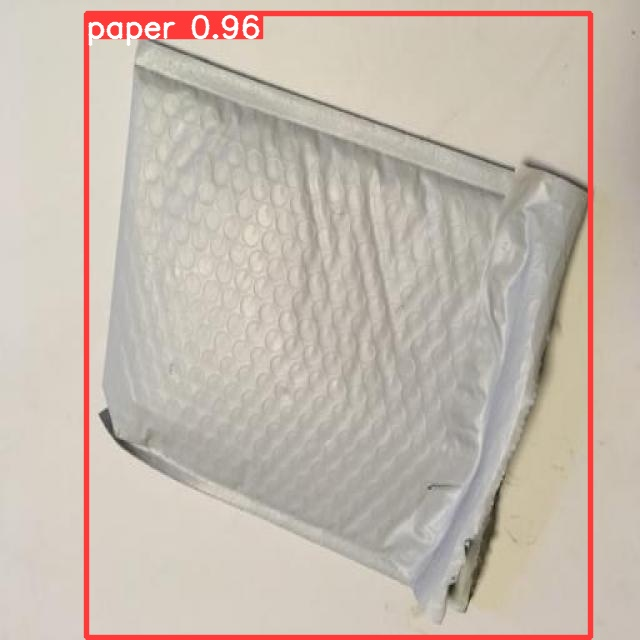

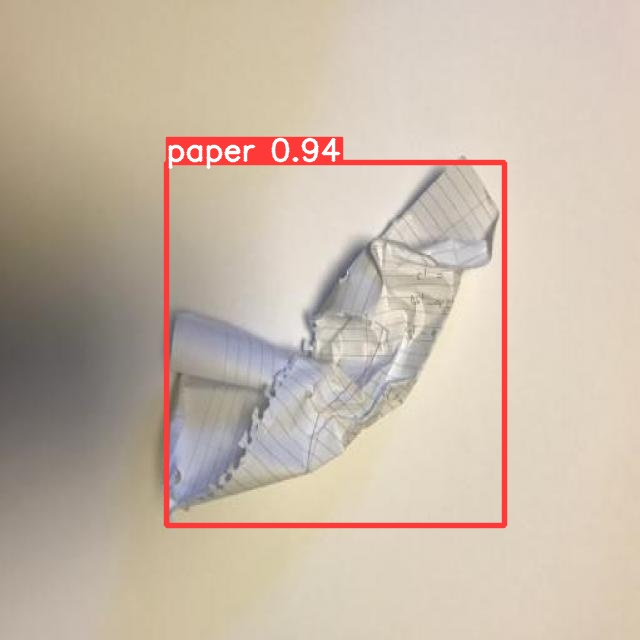

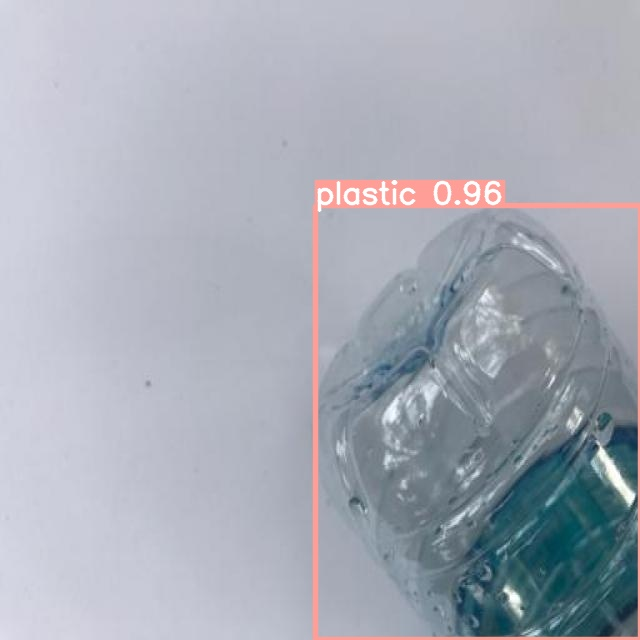

In [ ]:
# display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Step 6: Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

In [ ]:
# export your model's weights for future use
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# export a copy of your dataset (images + label)
!zip -r new_yolov5_dataset.zip /content/datasets
files.download('new_yolov5_dataset.zip') 

Streaming output truncated to the last 5000 lines.
  adding: content/datasets/garbage-classification-1/train/images/plastic-431-_jpg.rf.4def59872a26971964074ae87f432a53.jpg (deflated 7%)
  adding: content/datasets/garbage-classification-1/train/images/plastic-493-_jpg.rf.a6a10a5fce0a69a73034ff1e765a4a61.jpg (deflated 9%)
  adding: content/datasets/garbage-classification-1/train/images/plastic-749-_jpg.rf.1dc02230977a7a80170d8b22ba8a558f.jpg (deflated 2%)
  adding: content/datasets/garbage-classification-1/train/images/paper-468-_jpg.rf.fb4cfe26c17b1e7afc06a76d24913e4b.jpg (deflated 2%)
  adding: content/datasets/garbage-classification-1/train/images/paper-168-_jpg.rf.9dbb6bb913fcea12bb152260f5965788.jpg (deflated 22%)
  adding: content/datasets/garbage-classification-1/train/images/plastic-186-_JPG.rf.9c31b25cbb2770c2ea13f151953eb2b3.jpg (deflated 6%)
  adding: content/datasets/garbage-classification-1/train/images/plastic-216-_JPG.rf.0ad4df5b0c4303741558766fee503ea0.jpg (deflated 3%)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# export a copy of your model
!zip -r new_yolov5.zip /content/yolov5
files.download('new_yolov5.zip') 

  adding: content/yolov5/ (stored 0%)
  adding: content/yolov5/.pre-commit-config.yaml (deflated 60%)
  adding: content/yolov5/tutorial.ipynb (deflated 78%)
  adding: content/yolov5/benchmarks.py (deflated 68%)
  adding: content/yolov5/README.zh-CN.md (deflated 77%)
  adding: content/yolov5/utils/ (stored 0%)
  adding: content/yolov5/utils/downloads.py (deflated 60%)
  adding: content/yolov5/utils/__pycache__/ (stored 0%)
  adding: content/yolov5/utils/__pycache__/torch_utils.cpython-38.pyc (deflated 45%)
  adding: content/yolov5/utils/__pycache__/callbacks.cpython-38.pyc (deflated 53%)
  adding: content/yolov5/utils/__pycache__/dataloaders.cpython-38.pyc (deflated 51%)
  adding: content/yolov5/utils/__pycache__/plots.cpython-38.pyc (deflated 45%)
  adding: content/yolov5/utils/__pycache__/downloads.cpython-38.pyc (deflated 40%)
  adding: content/yolov5/utils/__pycache__/__init__.cpython-38.pyc (deflated 41%)
  adding: content/yolov5/utils/__pycache__/loss.cpython-38.pyc (deflated 46%)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>